# Common tumor-NAT differences

In [1]:
import pandas as pd
import numpy as np
import pickle
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegressionCV
from msresist.pre_processing import filter_NaNpeptides
from msresist.clustering import MassSpecClustering
from msresist.figures.figure1 import plotClustergram
from msresist.figures.figureM2 import TumorType
from msresist.figures.figure3 import plotPCA, plotCenters
from msresist.logistic_regression import plotClusterCoefficients, plotPredictionProbabilities, plotConfusionMatrix, plotROC


sns.set(style="whitegrid", font_scale=1.2, color_codes=True, palette="colorblind", rc={"grid.linestyle": "dotted", "axes.linewidth": 0.6})

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
# pd.set_option('display.max_colwidth', 1000)
# pd.set_option('display.max_rows', 1000000)
# pd.set_option('display.max_columns', 1000)

## Import and Preprocess Data

In [4]:
# X = preprocessing(CPTAC=True, log2T=True)
X = pd.read_csv("msresist/data/MS/CPTAC/CPTAC-preprocessedMotfis.csv").iloc[:, 1:]

# filter peptides with excessive missingness
X_f = filter_NaNpeptides(X, cut=0.1)
X_f.index = np.arange(X_f.shape[0])
d_f = X_f.select_dtypes(include=['float64']).T
i_f = X_f.select_dtypes(include=['object'])

X_f.head()

,Sequence,Protein,Gene,Position,C3N.01799,C3N.01799.N,C3L.01890,C3L.01890.N,C3N.00572,C3N.00572.N,C3N.02423,C3N.02423.N,C3N.02729,C3N.02729.N,C3L.00263,...,C3N.00738,C3N.00738.N,C3N.00959,C3N.00959.N,C3N.02003,C3N.02003.N,C3N.02379.N,C3N.00175,C3N.00175.N,C3N.01823,C3N.01823.N,C3L.02549,C3L.02549.N,C3L.02365,C3L.02365.N
0,AAAAAsQQGSA,NP_001308122.1,TBL1XR1,S119-p,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.071547,-0.600298,0.172339,-1.761406,0.421872,-0.372907,-0.979491,-0.083036,-0.361962,1.275506,-0.568015,0.25423,-0.378522,0.987749,-0.189486
1,AAAAGsASPRS,NP_064520.2,WRNIP1,S151-p,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AAAAGsGPSPP,NP_060895.1,PI4K2A,S44-p,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.83783,-0.993838,0.317079,...,0.031572,-0.554645,-0.033640,-1.268642,0.266790,-0.063300,-0.647500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,AAAAGsGPsPP,NP_060895.1,PI4K2A,S44-p;S47-p,0.477744,-1.231926,-1.600599,-1.349858,0.388473,-0.649326,0.394909,-1.041745,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AAAAPsPGSAR,NP_036253.2,CDC42EP4,S292-p,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Run Model
Filter peptides based on a threshold of missingness

In [5]:
# %%time
# ncl = 15
# MSC = MassSpecClustering(i_f, ncl=ncl, SeqWeight=0.075, distance_method="PAM250", n_runs=1).fit(d_f, "NA")
# MSC.wins_

use pickle to save/load model:

In [6]:
# with open('CPTACmodel_PAM250_W0075_15CL', 'wb') as f:
#     pickle.dump([MSC], f)

with open('CPTACmodel_PAM250_W1_15CL', 'rb') as f:
    MSC = pickle.load(f)[0]

## Hierarchical Clustering

In [62]:
centers = pd.DataFrame(MSC.transform())
centers["Patient_ID"] = X.columns[4:]
centers.iloc[:, :-1] = zscore(centers.iloc[:, :-1], axis=1)
centers.columns = list(np.arange(MSC.ncl) + 1) + ["Patient_ID"]

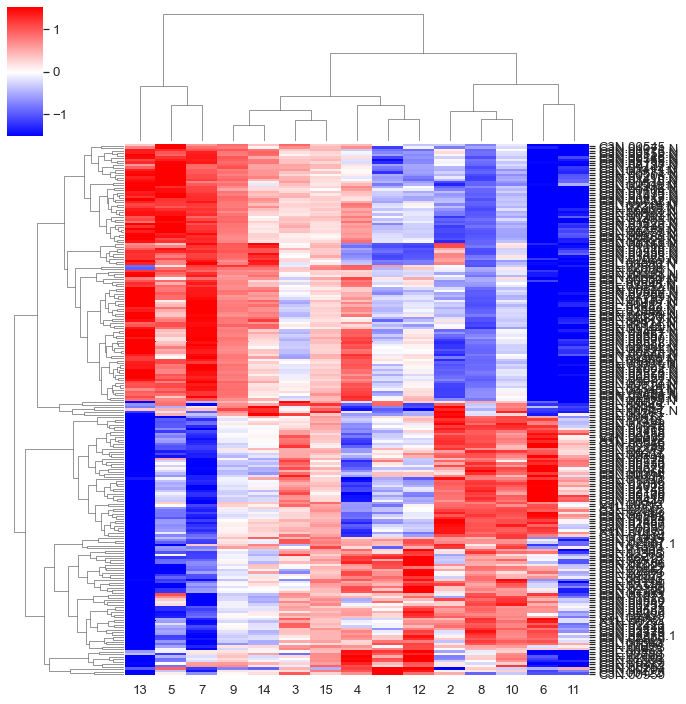

In [15]:
centers = centers.set_index(["Patient_ID"])
plotClustergram(centers, "", lim=max(np.max(np.abs(centers)) * 0.5), figsize=(10, 10), yticklabels=True)
centers = centers.reset_index()

## PCA Analysis

In [63]:
centers = TumorType(centers)

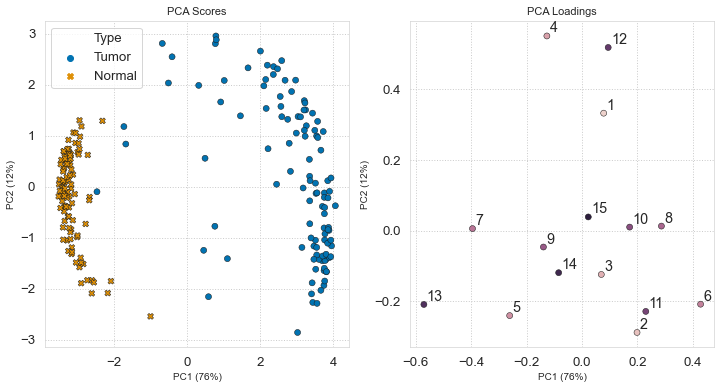

In [64]:
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
plotPCA(ax, centers, 2, ["Patient_ID", "Type"], "Cluster", hue_scores="Type", style_scores="Type", hue_load="Cluster")

## Regression against Sample Type (Tumor vs NAT)

In [65]:
c = centers.select_dtypes(include=['float64'])
tt = centers.iloc[:, -1]
tt = tt.replace("Normal", 0)
tt = tt.replace("Tumor", 1)

In [75]:
lr = LogisticRegressionCV(cv=MSC.ncl, solver="saga", penalty="l2").fit(c, tt)
y_pred = lr.predict(c)

lr_score = lr.score(c, tt)
print("LR prediction score: ", lr_score)

LR prediction score:  0.9953488372093023


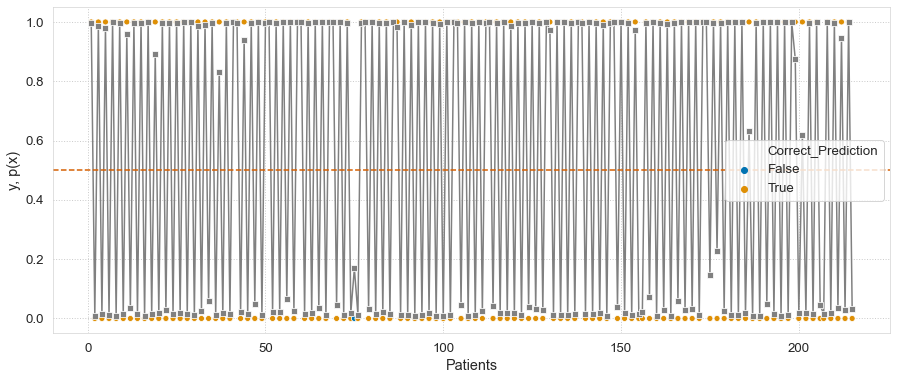

In [76]:
fig, ax = plt.subplots(1, 1, figsize=(15, 6))
plotPredictionProbabilities(ax, lr, y_pred, c, tt)

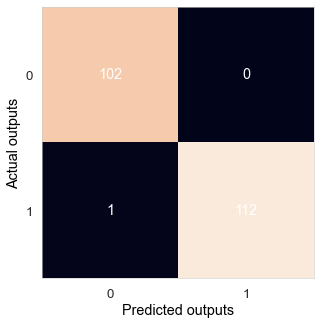

In [77]:
fig, ax = plt.subplots(figsize=(5, 5))
plotConfusionMatrix(ax, lr, c, tt)

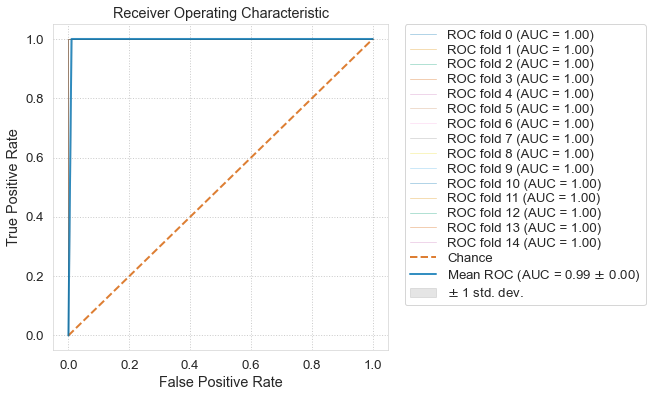

In [78]:
fig, ax = plt.subplots(figsize=(6, 6))
plotROC(ax, lr, c, tt, cv_folds=MSC.ncl)

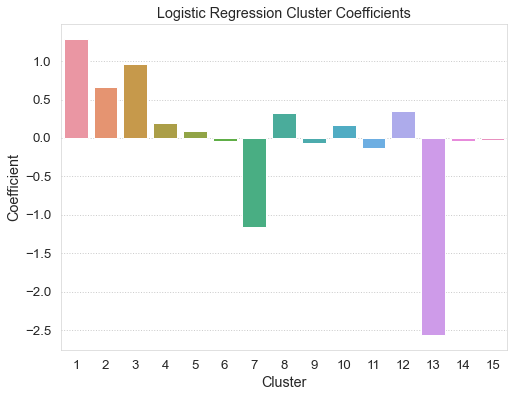

In [79]:
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
plotClusterCoefficients(ax, lr)

Using LASSO all clusters coefficients are 0 except from cluster 13, which is also heaviliy negatively weighted.

## Clusters tracking with NAT samples

### Clusters 1

Serine/Threonine cluster

In [74]:
x =  X_f.copy()
x["Cluster"] = MSC.labels_ + 1
print("Size of cluster 1:", len(MSC.cl_seqs_[0]))

Size of cluster 1: 648


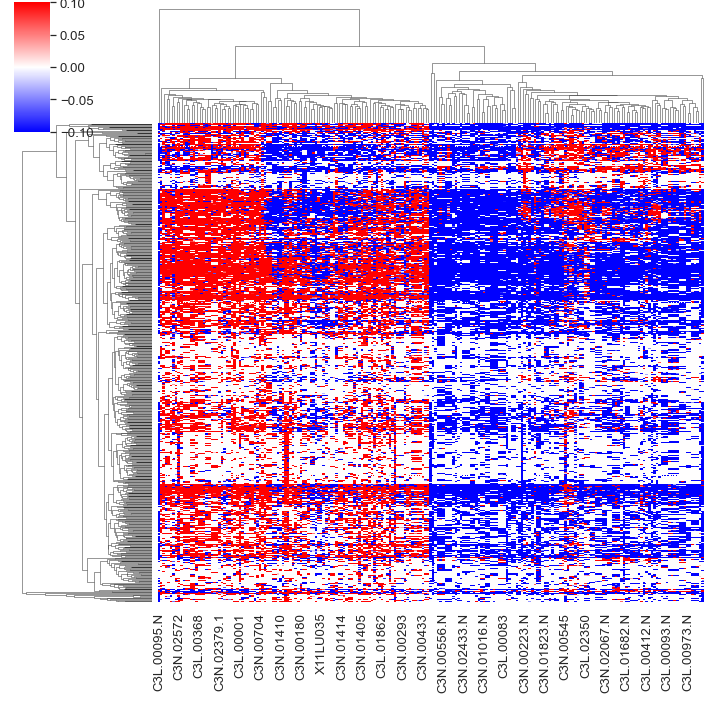

In [75]:
cl1 = x[x["Cluster"] == 1]
cl1D = cl1.iloc[:, 4:-1].fillna(0)

plotClustergram(cl1D)

### Further clusters tracking with NATs: 3, 10 ,12
all of them Serine/Threonine cluster

In [76]:
print("Size of cluster 3:", len(MSC.cl_seqs_[2]))
print("Size of cluster 10:", len(MSC.cl_seqs_[9]))
print("Size of cluster 12:", len(MSC.cl_seqs_[11]))

Size of cluster 3: 2698
Size of cluster 10: 536
Size of cluster 10: 2192


## Clusters tracking with Tumor samples

### Clusters 5

Serine/Threonine cluster

In [77]:
print("Size of cluster 1:", len(MSC.cl_seqs_[4]))

Size of cluster 1: 630


In [80]:
# cl5 = x[x["Cluster"] == 5]
# cl5D = cl5.iloc[:, 4:-1].fillna(0)

# plotClustergram(cl5D)

### Further clusters tracking with tumors: 7, 11 ,13
all of them Serine/Threonine cluster

In [79]:
print("Size of cluster 5:", len(MSC.cl_seqs_[4]))
print("Size of cluster 7:", len(MSC.cl_seqs_[6]))
print("Size of cluster 11:", len(MSC.cl_seqs_[10]))
print("Size of cluster 12:", len(MSC.cl_seqs_[12]))

Size of cluster 5: 630
Size of cluster 7: 898
Size of cluster 11: 3034
Size of cluster 12: 2248
